## Exploration Data Analysis for ExioML

### Visualisation of Factor Accounting Table

In [132]:
import pandas as pd
import numpy as np

import warnings
warnings.filterwarnings('ignore')

file_path = "data/output"
name = "factor_account"
type = "pxp"

fa_pxp = pd.read_csv(f'{file_path}/{name}_{type}.csv')

fa_pxp.describe()

,Value Added [M.EUR],Employment [1000 p.],GHG emissions [kg CO2 eq.],Energy Carrier Net Total [TJ],Year
count,2.213060e+05,2.213060e+05,2.213060e+05,2.213060e+05,221306.000000
mean,6.365042e+03,3.956925e+02,4.515220e+09,4.761701e+04,2008.552773
std,4.189189e+04,2.978349e+03,4.386312e+10,3.495080e+05,8.085673
min,3.630152e-23,7.304634e-15,5.078559e-06,8.298838e-10,1995.000000
25%,1.447573e+01,2.945295e-01,1.438288e+07,2.292775e+02,2002.000000
50%,2.207293e+02,5.618992e+00,1.735501e+08,2.471739e+03,2009.000000
75%,1.881704e+03,6.424253e+01,1.180402e+09,1.589944e+04,2016.000000
max,2.773712e+06,2.370236e+05,3.810351e+12,2.957928e+07,2022.000000


In [133]:
# Numeric columns
numeric_columns = ['Value Added [M.EUR]', 'Employment [1000 p.]', 'GHG emissions [kg CO2 eq.]', 'Energy Carrier Net Total [TJ]']

for col in numeric_columns:
        fa_pxp[col] = np.log(fa_pxp[col])  # abs() handles negative values

fa_pxp

,region,sector,Value Added [M.EUR],Employment [1000 p.],GHG emissions [kg CO2 eq.],Energy Carrier Net Total [TJ],Year
0,AT,Wheat,5.153731,2.522899,19.816235,7.578938,1995
1,AT,Cereal grains nec,5.963745,3.212165,20.531675,8.166458,1995
2,AT,"Vegetables, fruit, nuts",6.721656,3.883946,19.446436,7.997973,1995
3,AT,Oil seeds,4.633350,1.075206,18.895650,5.580073,1995
4,AT,"Sugar cane, sugar beet",3.457970,1.144672,18.425450,5.393289,1995
...,...,...,...,...,...,...,...
221301,WM,Wood waste for treatment: landfill,5.597926,1.712930,20.995406,7.840760,2022
221302,WM,Membership organisation services n.e.c. (91),9.280214,5.064775,20.162108,10.269288,2022
221303,WM,"Recreational, cultural and sporting services (92)",10.325222,5.892359,21.968864,11.011685,2022
221304,WM,Other services (93),9.879680,5.221791,22.369331,11.298246,2022


In [134]:
import textwrap

def top_k_largest_sector(df, k, column):
    top_k_sector = df.groupby(["sector"]).sum().nlargest(k, column)
    top_k = df[df["sector"].isin(top_k_sector.index)].sort_values(by=column, ascending=False)

    # Wrap the sector names if they are too long
    top_k['sector'] = top_k['sector'].apply(lambda x: '\n'.join(textwrap.wrap(x, width=20)))
    
    return top_k

In [135]:
top_k = top_k_largest_sector(fa_pxp, 20, "Employment [1000 p.]")
top_k

,region,sector,Value Added [M.EUR],Employment [1000 p.],GHG emissions [kg CO2 eq.],Energy Carrier Net Total [TJ],Year
218232,CN,"Vegetables, fruit,\nnuts",12.598268,12.375915,25.193952,12.861600,2022
210265,CN,"Vegetables, fruit,\nnuts",12.481078,12.271458,25.089915,12.758205,2021
202293,CN,"Vegetables, fruit,\nnuts",12.409680,12.219482,25.095190,12.707291,2020
194332,CN,"Vegetables, fruit,\nnuts",12.405243,12.147181,25.070613,12.636050,2019
220946,WF,"Vegetables, fruit,\nnuts",11.222559,12.058570,24.034688,6.543416,2022
...,...,...,...,...,...,...,...
12829,CN,Real estate services\n(70),8.301809,-11.577720,22.854652,11.581714,1996
106484,JP,Machinery and\nequipment n.e.c.\n(29),10.883285,-12.580602,22.094609,11.585069,2008
92139,RU,Other business\nservices (74),-10.807069,-13.705766,19.297553,8.279697,2006
92137,RU,Computer and related\nservices (72),3.396872,-13.835644,22.155820,11.002683,2006


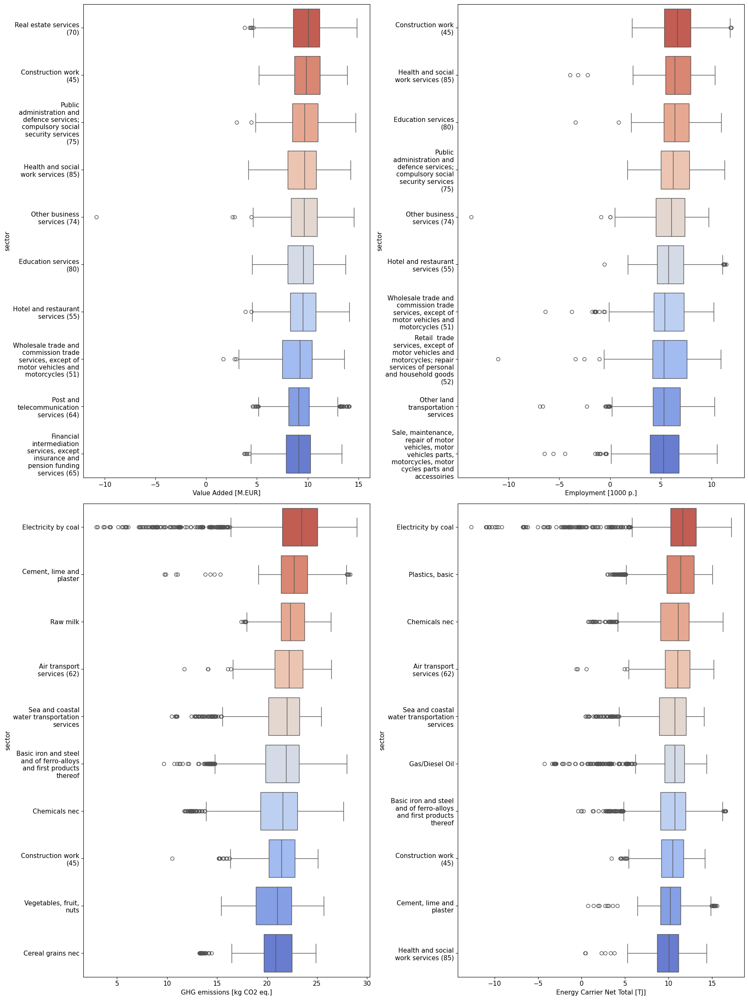

In [147]:
import matplotlib.pyplot as plt
import matplotlib as mpl
import seaborn as sns

# Set global font size
mpl.rcParams['font.size'] = 11

fig, axs = plt.subplots(2, 2, figsize=(18, 24))

top_k = top_k_largest_sector(fa_pxp, 10, "Value Added [M.EUR]")
order = top_k.groupby("sector")["Value Added [M.EUR]"].median().sort_values(ascending= False).index
sns.boxplot(x="Value Added [M.EUR]", y="sector", data=top_k, ax=axs[0,0], order=order, palette="coolwarm_r")

top_k = top_k_largest_sector(fa_pxp, 10, "Employment [1000 p.]")
order = top_k.groupby("sector")["Employment [1000 p.]"].median().sort_values(ascending= False).index
sns.boxplot(x="Employment [1000 p.]", y="sector", data=top_k, ax=axs[0,1], order=order, palette="coolwarm_r")

top_k = top_k_largest_sector(fa_pxp, 10, "GHG emissions [kg CO2 eq.]")
order = top_k.groupby("sector")["GHG emissions [kg CO2 eq.]"].median().sort_values(ascending= False).index
sns.boxplot(x="GHG emissions [kg CO2 eq.]", y="sector", data=top_k, ax=axs[1, 0], order=order, palette="coolwarm_r")

top_k = top_k_largest_sector(fa_pxp, 10, "Energy Carrier Net Total [TJ]")
order = top_k.groupby("sector")["Energy Carrier Net Total [TJ]"].median().sort_values(ascending= False).index
sns.boxplot(x="Energy Carrier Net Total [TJ]", y="sector", data=top_k, ax=axs[1, 1], palette="coolwarm_r", order= order)

plt.tight_layout()
plt.show()

<Figure size 1800x2400 with 0 Axes>

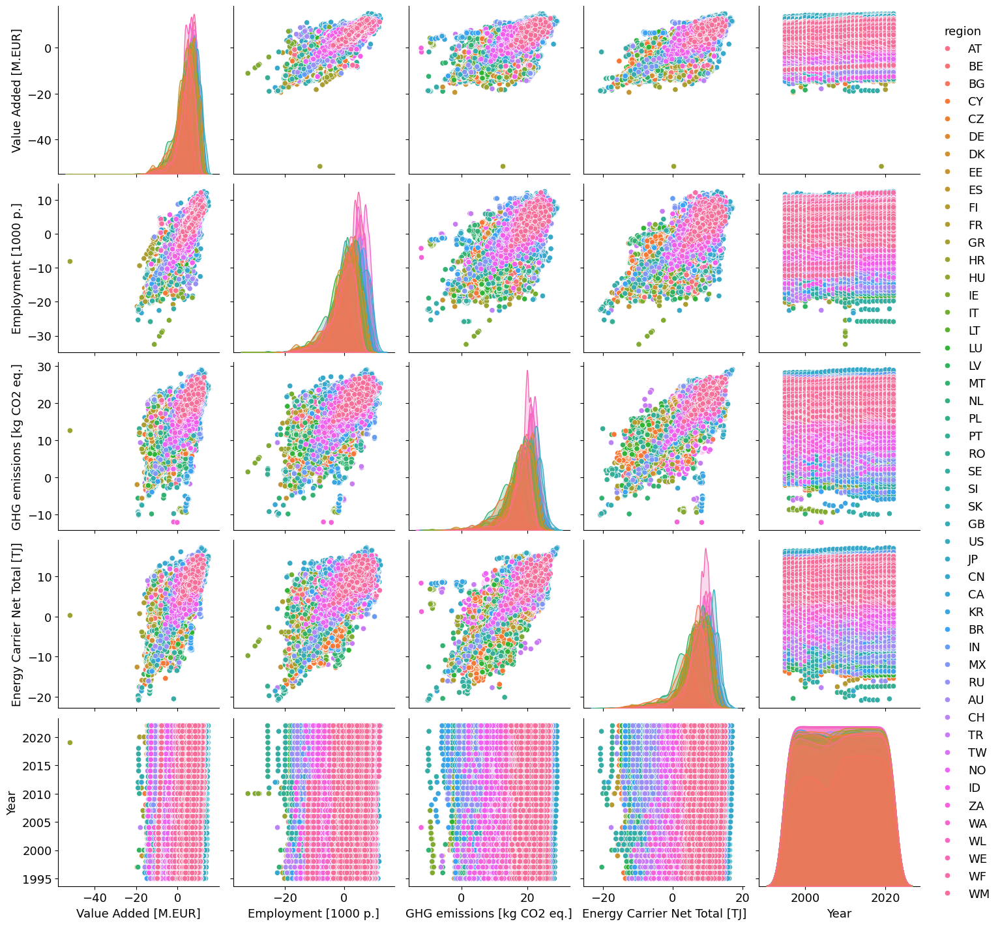

In [143]:
# Plot the pairplot for CN, BR, US and JP

figure = plt.figure(figsize=(18, 24))

sns.pairplot(fa_pxp,size = 2.9, hue='region', kind ='scatter',diag_kind='kde')


# set legend top right
plt.show()

### Visualisation of Footprint Network

In [1]:
import pandas as pd
import numpy as np

import warnings
warnings.filterwarnings('ignore')

file_path = "data/output"
name = "footprint"
type = "pxp"

fa_pxp = pd.read_csv(f'{file_path}/{name}_{type}.csv')

In [215]:
import networkx as nx
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
from matplotlib.patches import Patch
import numpy as np
import seaborn as sns
import matplotlib as mpl

# Function to extract region code from node name
def extract_region(node_name):
    parts = node_name.split('_')
    if len(parts) > 0:
        return parts[0]  # Return the country or region code
    return 'Unknown'  # Fallback for any names that don't follow the expected format

def build_networks(df, colour = "viridis", year = 1995):
    # Set a random seed for reproducibility
    node_size = 20
    scale = 5
   #np.random.seed(42)
    
    # Create subplots
    fig, axs = plt.subplots(1, 4, figsize=(40, 11), sharex=True, sharey=True)
    
    # Create two directed graphs
    G1 = nx.DiGraph()
    G2 = nx.DiGraph()
    G3 = nx.DiGraph()
    G4 = nx.DiGraph()
    
    # Add edges along with their weights
    for idx, row in df.iterrows():
        G1.add_edge(row['Source'], row['Target'], weight=row["Value Added [M.EUR]"])
        G2.add_edge(row['Source'], row['Target'], weight=row["Employment [1000 p.]"])
        G3.add_edge(row['Source'], row['Target'], weight=row["GHG emissions [kg CO2 eq.]"])
        G4.add_edge(row['Source'], row['Target'], weight=row["Energy Carrier Net Total [TJ]"])
        
    # Display a set of unique node names to analyze the structure and extract the sector
    unique_nodes = set(df['Source']).union(set(df['Target']))
    
    # Extract regions and assign a unique color to each region
    regions = {extract_region(node) for node in unique_nodes}
    palette = sns.color_palette(colour, len(regions))
    region_color_map = {region: palette[i] for i, region in enumerate(sorted(regions))}

#     color_map = ListedColormap(np.random.rand(len(regions), 3))
#     region_color_map = {region: color for region, color in zip(regions, color_map.colors)}
    
    # Sort nodes alphabetically for circular layout
    sorted_nodes = sorted(G1.nodes(), reverse=True)
    pos = nx.shell_layout(sorted_nodes)
    
    # Plotting for G1
    node_colors_1 = [region_color_map[extract_region(node)] for node in G1.nodes()]
    edge_colors_1 = [region_color_map[extract_region(edge[0])] for edge in G1.edges()]
    nx.draw(G1, pos, ax=axs[0], width=[edge[2]['weight'] / scale for edge in G1.edges(data=True)], node_size=node_size,
            node_color=node_colors_1, with_labels=False, font_size=10, font_weight='bold', edge_color=edge_colors_1)
    axs[0].set_title(f'Value Added Footprint {year}')
    
    # Plotting for G2
    node_colors_2 = [region_color_map[extract_region(node)] for node in G2.nodes()]
    edge_colors_2 = [region_color_map[extract_region(edge[0])] for edge in G2.edges()]
    nx.draw(G2, pos, ax=axs[1], width=[edge[2]['weight'] / scale for edge in G2.edges(data=True)], node_size=node_size,
            node_color=node_colors_2, with_labels=False, font_size=10, font_weight='bold', edge_color=edge_colors_2)
    axs[1].set_title(f'Employment Footprint {year}')
    
    # Plotting for G3
    node_colors_3 = [region_color_map[extract_region(node)] for node in G3.nodes()]
    edge_colors_3 = [region_color_map[extract_region(edge[0])] for edge in G3.edges()]
    nx.draw(G3, pos, ax=axs[2], width=[edge[2]['weight'] / scale for edge in G3.edges(data=True)], node_size=node_size,
            node_color=node_colors_3, with_labels=False, font_size=10, font_weight='bold', edge_color=edge_colors_3)
    axs[2].set_title(f'Emission Footprint {year}')
    
    # Plotting for G2
    node_colors_4 = [region_color_map[extract_region(node)] for node in G4.nodes()]
    edge_colors_4 = [region_color_map[extract_region(edge[0])] for edge in G4.edges()]
    nx.draw(G4, pos, ax=axs[3], width=[edge[2]['weight'] / scale for edge in G4.edges(data=True)], node_size=node_size,
            node_color=node_colors_4, with_labels=False, font_size=10, font_weight='bold', edge_color=edge_colors_4)
    axs[3].set_title(f'Energy Usage Footprint {year}')
    
    # Create a custom legend for the region colors sorted alphabetically
    # sorted_region_color_map = dict(sorted(region_color_map.items(), key=lambda item: item[0]))
    # legend_elements = [Patch(facecolor=color, label=region) for region, color in sorted_region_color_map.items()]
    # plt.legend(handles=legend_elements, bbox_to_anchor=(0.5, -0.05), ncol=len(legend_elements), title="Regions")
    
    # # Set a common ylabel
    #fig.text(0.001, 0.5, str(year), va='center', rotation='vertical', fontsize=30)
    
    # save image
    
    plt.tight_layout()
    plt.savefig(f'network_{year}.png')
    plt.show()
    return plt

In [205]:
def top_k_network(df, k, year, colour = "viridis"):
    sub_fa_pxp = df[df["Year"].isin([year])]
    top_fa_pxp = sub_fa_pxp.nlargest(k, "Value Added [M.EUR]")

    # Numeric columns
    numeric_columns = ['Value Added [M.EUR]', 'Employment [1000 p.]', 'GHG emissions [kg CO2 eq.]', 'Energy Carrier Net Total [TJ]']

    for col in numeric_columns:
            top_fa_pxp[col] = np.log(top_fa_pxp[col])  # abs() handles negative values
            top_fa_pxp[col] = top_fa_pxp[col] / top_fa_pxp[col].max()  # Normalize the values

    # Remove self-loops
    top_fa_pxp = top_fa_pxp[top_fa_pxp["Source"] != top_fa_pxp["Target"]]

    build_networks(top_fa_pxp, colour = colour, year = year)

In [203]:
top_k_network(fa_pxp, 100, 1995, colour = "viridis")

,Source,Target,Value Added [M.EUR],Employment [1000 p.],Energy Carrier Net Total [TJ],GHG emissions [kg CO2 eq.],Year
24,US_Other business services (74),US_Public administration and defence services;...,0.835586,0.656881,0.812803,0.895184,1995
39,US_Other business services (74),US_Health and social work services (85),0.810054,0.623861,0.789430,0.881494,1995
53,US_Post and telecommunication services (64),US_Public administration and defence services;...,0.797331,0.572485,0.705224,0.851259,1995
68,JP_Chemicals nec,JP_Health and social work services (85),0.781232,0.564207,0.867483,0.967514,1995
79,JP_Other land transportation services,JP_Construction work (45),0.774534,0.619983,0.490330,0.734283,1995
82,US_Other business services (74),US_Construction work (45),0.773168,0.576158,0.755663,0.861716,1995
85,JP_Other business services (74),JP_Construction work (45),0.769615,0.629168,0.674528,0.805222,1995
90,"JP_Fabricated metal products, except machinery...",JP_Construction work (45),0.766248,0.615373,0.751379,0.853711,1995


In [40]:
mpl.rcParams['font.size'] = 30

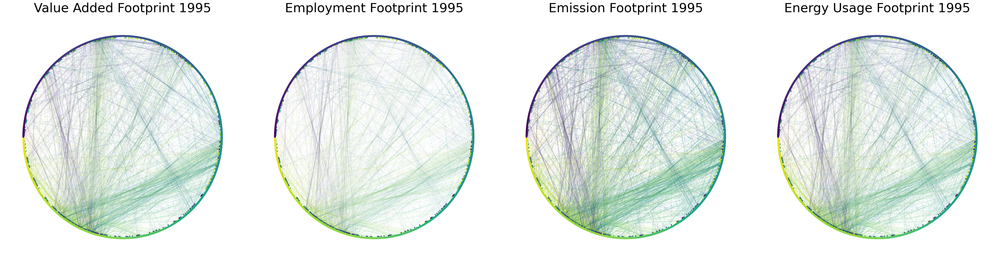

In [217]:
top_k_network(fa_pxp, k = 10000, year = 1995, colour = "viridis")

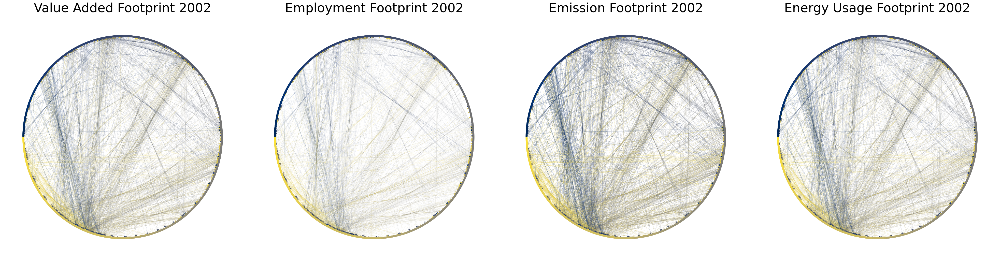

In [218]:
top_k_network(fa_pxp, k = 10000, year = 2002, colour = "cividis")

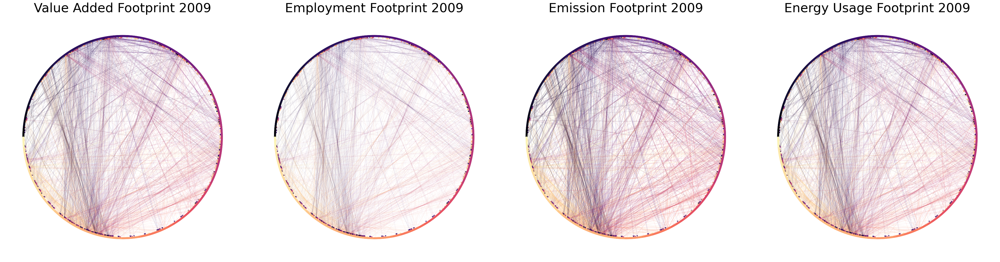

In [216]:
top_k_network(fa_pxp, k = 10000, year = 2009, colour = "magma")

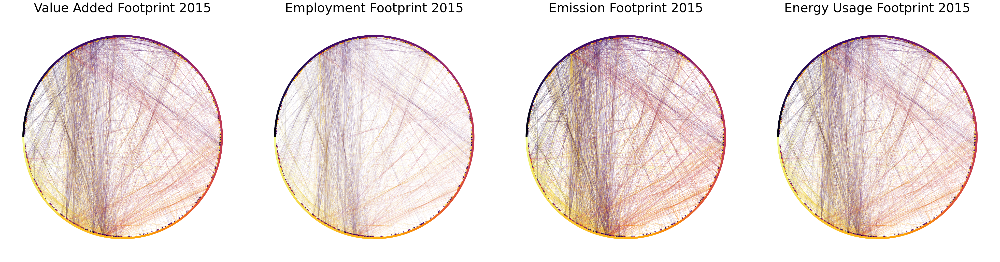

In [222]:
top_k_network(fa_pxp, k = 10000, year = 2015, colour = "inferno")

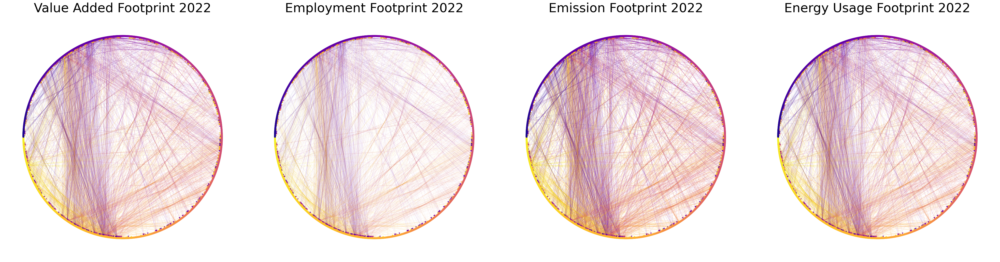

In [220]:
top_k_network(fa_pxp, k = 10000, year = 2022, colour = "plasma")

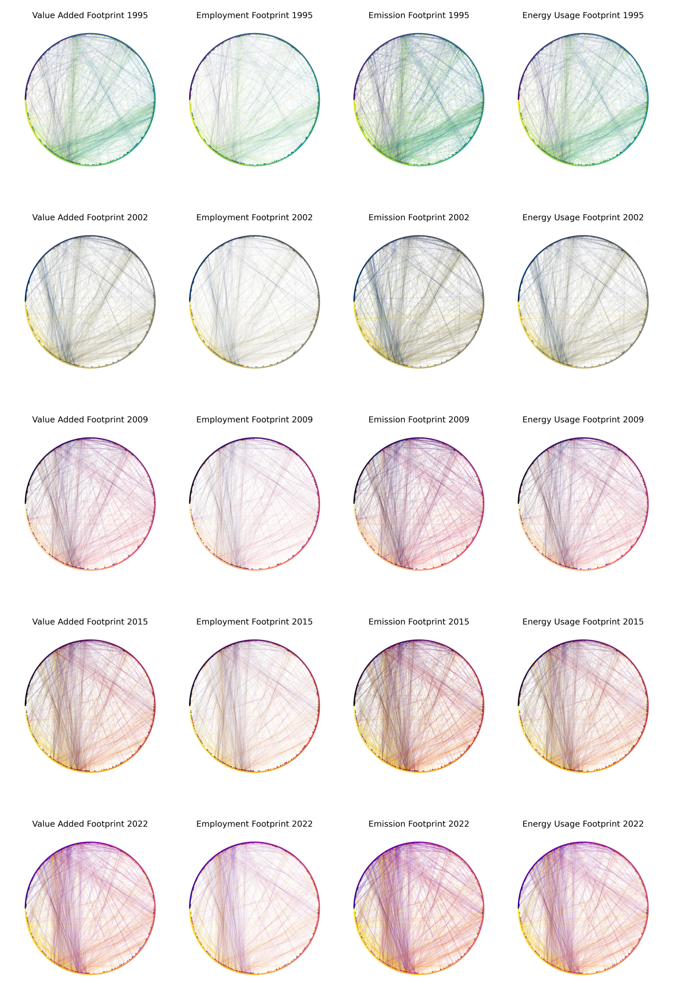

In [223]:
from PIL import Image

# 假设你已经保存了两个图像
img1 = Image.open('network_1995.png')
img2 = Image.open('network_2002.png')
img3 = Image.open('network_2009.png')
img4 = Image.open('network_2015.png')
img5 = Image.open('network_2022.png')

# 在subplot中显示它们
fig, axs = plt.subplots(5, 1, figsize=(18, 24))
axs[0].imshow(img1)
axs[0].axis('off')  # 关闭坐标轴

axs[1].imshow(img2)
axs[1].axis('off')

axs[2].imshow(img3)
axs[2].axis('off')

axs[3].imshow(img4)
axs[3].axis('off')

axs[4].imshow(img5)
axs[4].axis('off')

plt.tight_layout()
plt.show()